In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/eda-on-ev/growth_rate_analysis.csv
/kaggle/input/eda-on-ev/yearly_sales_trend.csv
/kaggle/input/eda-on-ev/enhanced_ev_dataset.csv


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

# Set style for better visualizations
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Configure display options
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)

print("="*80)
print("ELECTRIC VEHICLE DATASET - EXPLORATORY DATA ANALYSIS")
print("="*80)

ELECTRIC VEHICLE DATASET - EXPLORATORY DATA ANALYSIS


data loading 


In [4]:
print("\n" + "="*80)
print("1. LOADING DATASETS")
print("="*80)

# Load datasets
df_enhanced = pd.read_csv('/kaggle/input/eda-on-ev/enhanced_ev_dataset.csv')
df_growth = pd.read_csv('/kaggle/input/eda-on-ev/growth_rate_analysis.csv')
df_yearly = pd.read_csv('/kaggle/input/eda-on-ev/yearly_sales_trend.csv')

print("\n✓ All datasets loaded successfully!")
print(f"\n📊 Enhanced EV Dataset: {df_enhanced.shape[0]} rows × {df_enhanced.shape[1]} columns")
print(f"📊 Growth Rate Analysis: {df_growth.shape[0]} rows × {df_growth.shape[1]} columns")
print(f"📊 Yearly Sales Trend: {df_yearly.shape[0]} rows × {df_yearly.shape[1]} columns")



1. LOADING DATASETS

✓ All datasets loaded successfully!

📊 Enhanced EV Dataset: 96845 rows × 8 columns
📊 Growth Rate Analysis: 5 rows × 22 columns
📊 Yearly Sales Trend: 11 rows × 3 columns


 data overview 

In [5]:
print("\n" + "="*80)
print("2. DATASET OVERVIEW")
print("="*80)

print("\n--- Enhanced EV Dataset ---")
print(df_enhanced.head())
print("\nColumn Names:", df_enhanced.columns.tolist())
print("\nData Types:\n", df_enhanced.dtypes)
print("\nBasic Statistics:\n", df_enhanced.describe())

print("\n--- Growth Rate Analysis ---")
print(df_growth.head())
print("\nColumn Names:", df_growth.columns.tolist())
print("\nData Types:\n", df_growth.dtypes)
print("\nBasic Statistics:\n", df_growth.describe())

print("\n--- Yearly Sales Trend ---")
print(df_yearly.head())
print("\nColumn Names:", df_yearly.columns.tolist())
print("\nData Types:\n", df_yearly.dtypes)
print("\nBasic Statistics:\n", df_yearly.describe())



2. DATASET OVERVIEW

--- Enhanced EV Dataset ---
   Year Month_Name        Date           State         Vehicle_Class  \
0  2014        jan  2014-01-01  Andhra Pradesh       ADAPTED VEHICLE   
1  2014        jan  2014-01-01  Andhra Pradesh  AGRICULTURAL TRACTOR   
2  2014        jan  2014-01-01  Andhra Pradesh             AMBULANCE   
3  2014        jan  2014-01-01  Andhra Pradesh   ARTICULATED VEHICLE   
4  2014        jan  2014-01-01  Andhra Pradesh                   BUS   

  Vehicle_Category Vehicle_Type  EV_Sales_Quantity  
0           Others       Others                  0  
1           Others       Others                  0  
2           Others       Others                  0  
3           Others       Others                  0  
4              Bus          Bus                  0  

Column Names: ['Year', 'Month_Name', 'Date', 'State', 'Vehicle_Class', 'Vehicle_Category', 'Vehicle_Type', 'EV_Sales_Quantity']

Data Types:
 Year                  int64
Month_Name           object


In [6]:
print("\n" + "="*80)
print("3. DATA QUALITY ANALYSIS")
print("="*80)

def check_data_quality(df, name):
    print(f"\n--- {name} ---")
    print(f"\nTotal Records: {len(df)}")
    print(f"\nMissing Values:")
    missing = df.isnull().sum()
    missing_pct = (missing / len(df)) * 100
    missing_df = pd.DataFrame({'Missing Count': missing, 'Percentage': missing_pct})
    print(missing_df[missing_df['Missing Count'] > 0])
    
    print(f"\nDuplicate Rows: {df.duplicated().sum()}")
    
    return missing, missing_pct

missing_enhanced, pct_enhanced = check_data_quality(df_enhanced, "Enhanced EV Dataset")
missing_growth, pct_growth = check_data_quality(df_growth, "Growth Rate Analysis")
missing_yearly, pct_yearly = check_data_quality(df_yearly, "Yearly Sales Trend")



3. DATA QUALITY ANALYSIS

--- Enhanced EV Dataset ---

Total Records: 96845

Missing Values:
Empty DataFrame
Columns: [Missing Count, Percentage]
Index: []

Duplicate Rows: 0

--- Growth Rate Analysis ---

Total Records: 5

Missing Values:
Empty DataFrame
Columns: [Missing Count, Percentage]
Index: []

Duplicate Rows: 0

--- Yearly Sales Trend ---

Total Records: 11

Missing Values:
Empty DataFrame
Columns: [Missing Count, Percentage]
Index: []

Duplicate Rows: 0



4. GENERATING VISUALIZATIONS

--- Analyzing Enhanced EV Dataset ---


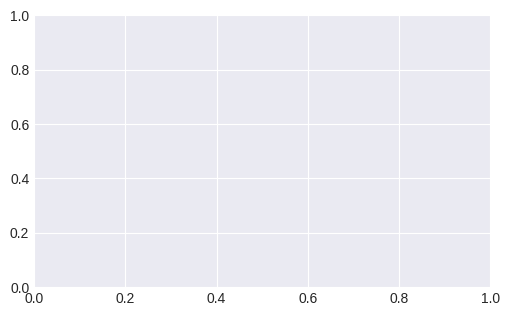

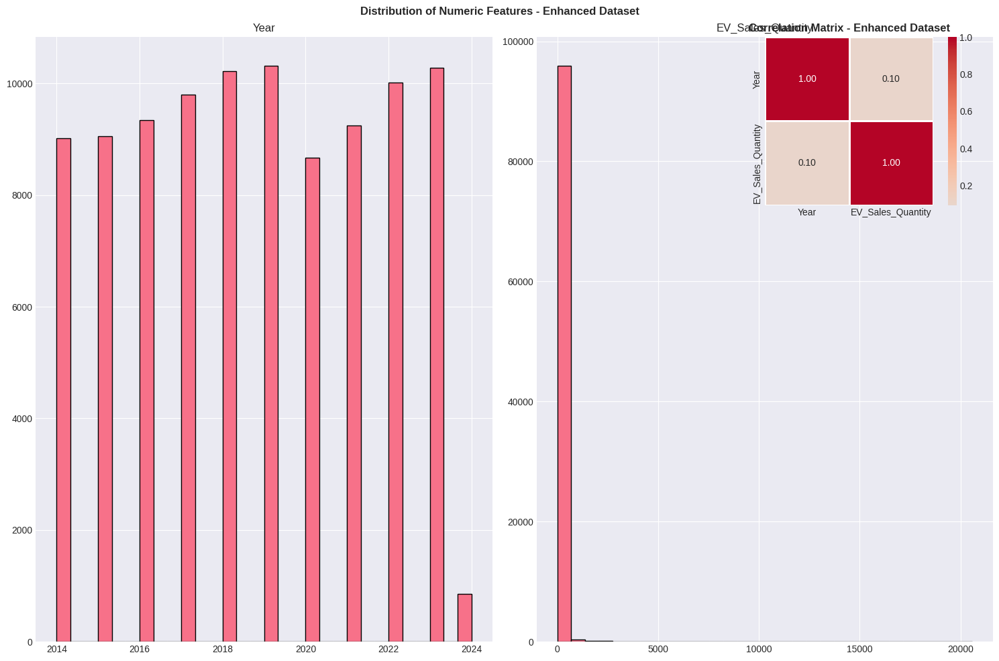


Categorical Columns Found: ['Month_Name', 'Date', 'State', 'Vehicle_Class', 'Vehicle_Category', 'Vehicle_Type']


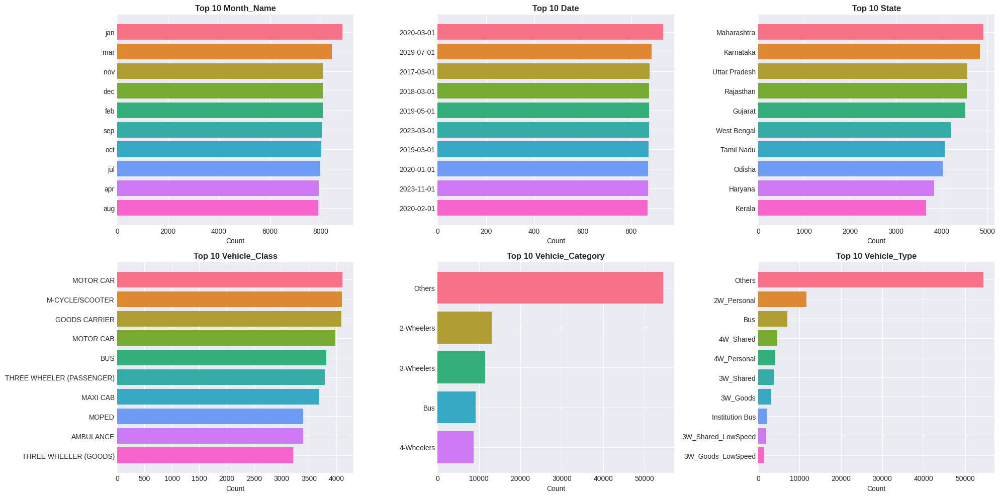

In [7]:
print("\n" + "="*80)
print("4. GENERATING VISUALIZATIONS")
print("="*80)

# ============================================================================
# 4.1 ENHANCED EV DATASET ANALYSIS
# ============================================================================
print("\n--- Analyzing Enhanced EV Dataset ---")

# Create figure with multiple subplots
fig = plt.figure(figsize=(20, 12))

# Plot 1: Missing values heatmap
if missing_enhanced.sum() > 0:
    plt.subplot(3, 3, 1)
    sns.heatmap(df_enhanced.isnull(), cbar=True, yticklabels=False, cmap='viridis')
    plt.title('Missing Values Heatmap - Enhanced Dataset', fontsize=12, fontweight='bold')

# Plot 2: Numeric columns distribution
numeric_cols = df_enhanced.select_dtypes(include=[np.number]).columns.tolist()
if len(numeric_cols) > 0:
    plt.subplot(3, 3, 2)
    df_enhanced[numeric_cols].hist(bins=30, figsize=(15, 10), edgecolor='black')
    plt.suptitle('Distribution of Numeric Features - Enhanced Dataset', fontsize=12, fontweight='bold')
    plt.tight_layout()

# Plot 3: Correlation heatmap
if len(numeric_cols) > 1:
    plt.subplot(3, 3, 3)
    corr_matrix = df_enhanced[numeric_cols].corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, 
                square=True, linewidths=1, fmt='.2f')
    plt.title('Correlation Matrix - Enhanced Dataset', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

# Categorical analysis for enhanced dataset
categorical_cols = df_enhanced.select_dtypes(include=['object']).columns.tolist()
if len(categorical_cols) > 0:
    print(f"\nCategorical Columns Found: {categorical_cols}")
    
    # Plot categorical distributions
    n_cats = min(6, len(categorical_cols))
    fig, axes = plt.subplots(2, 3, figsize=(20, 10))
    axes = axes.flatten()
    
    for idx, col in enumerate(categorical_cols[:n_cats]):
        value_counts = df_enhanced[col].value_counts().head(10)
        axes[idx].barh(range(len(value_counts)), value_counts.values, color=sns.color_palette("husl", len(value_counts)))
        axes[idx].set_yticks(range(len(value_counts)))
        axes[idx].set_yticklabels(value_counts.index)
        axes[idx].set_xlabel('Count')
        axes[idx].set_title(f'Top 10 {col}', fontweight='bold')
        axes[idx].invert_yaxis()
    
    plt.tight_layout()
    plt.show()


--- Analyzing Growth Rate Dataset ---


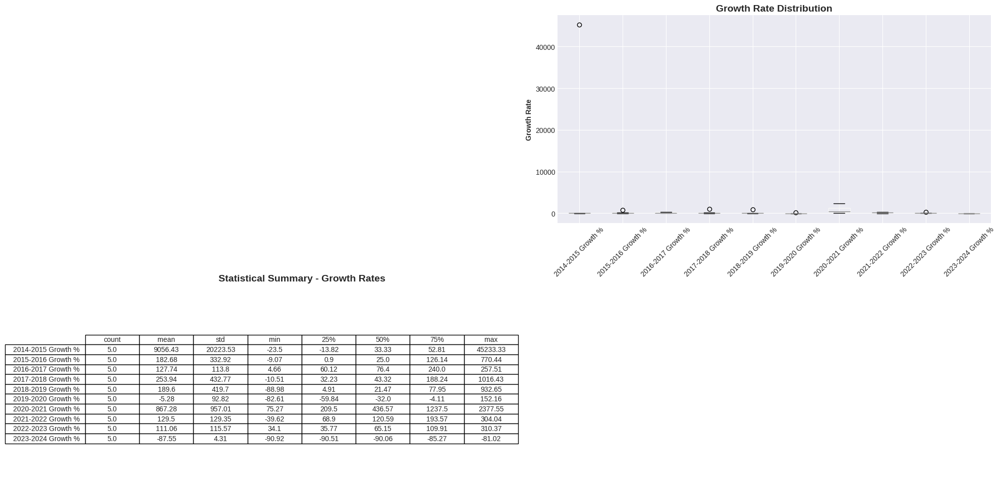

In [8]:
print("\n--- Analyzing Growth Rate Dataset ---")

fig = plt.figure(figsize=(20, 10))

# Identify year and growth columns
year_cols = [col for col in df_growth.columns if 'year' in col.lower()]
growth_cols = [col for col in df_growth.columns if 'growth' in col.lower() or 'rate' in col.lower()]

if year_cols and growth_cols:
    plt.subplot(2, 2, 1)
    for growth_col in growth_cols[:3]:  # Plot first 3 growth columns
        if growth_col in df_growth.columns:
            plt.plot(df_growth[year_cols[0]], df_growth[growth_col], marker='o', label=growth_col, linewidth=2)
    plt.xlabel('Year', fontweight='bold')
    plt.ylabel('Growth Rate', fontweight='bold')
    plt.title('Growth Rate Trends Over Time', fontsize=14, fontweight='bold')
    plt.legend()
    plt.grid(True, alpha=0.3)

# Box plot for growth rates
if growth_cols:
    plt.subplot(2, 2, 2)
    df_growth[growth_cols].boxplot()
    plt.title('Growth Rate Distribution', fontsize=14, fontweight='bold')
    plt.ylabel('Growth Rate', fontweight='bold')
    plt.xticks(rotation=45)

# Statistical summary
plt.subplot(2, 2, 3)
if growth_cols:
    stats_data = df_growth[growth_cols].describe().T
    plt.table(cellText=stats_data.values.round(2), 
              rowLabels=stats_data.index,
              colLabels=stats_data.columns,
              cellLoc='center',
              loc='center')
    plt.axis('off')
    plt.title('Statistical Summary - Growth Rates', fontsize=14, fontweight='bold')

plt.tight_layout()
plt.show()



--- Analyzing Yearly Sales Trend ---
Year columns found: ['Year']
Sales columns found: ['sum', 'mean']


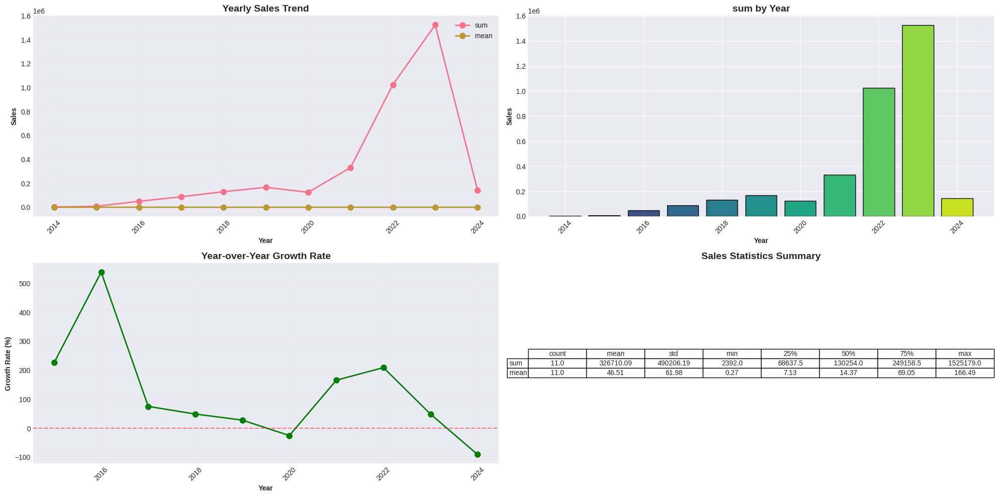

In [9]:

# ============================================================================
print("\n--- Analyzing Yearly Sales Trend ---")

# Identify sales and year columns with more flexible matching
sales_cols = [col for col in df_yearly.columns if any(keyword in col.lower() for keyword in ['sales', 'revenue', 'units', 'total', 'count', 'volume'])]
year_cols_yearly = [col for col in df_yearly.columns if 'year' in col.lower()]

# If no specific sales columns found, use all numeric columns except year
if not sales_cols:
    numeric_yearly = df_yearly.select_dtypes(include=[np.number]).columns.tolist()
    sales_cols = [col for col in numeric_yearly if col not in year_cols_yearly]

# If no year column found, check if there's a date or time column
if not year_cols_yearly:
    year_cols_yearly = [col for col in df_yearly.columns if any(keyword in col.lower() for keyword in ['date', 'time', 'period'])]

# If still nothing found, use index or first column
if not year_cols_yearly and len(df_yearly.columns) > 0:
    year_cols_yearly = [df_yearly.columns[0]]

print(f"Year columns found: {year_cols_yearly}")
print(f"Sales columns found: {sales_cols}")

if year_cols_yearly and sales_cols:
    fig = plt.figure(figsize=(20, 10))
    
    # Line plot for sales trends
    plt.subplot(2, 2, 1)
    for sales_col in sales_cols[:3]:  # Plot first 3 sales columns
        if sales_col in df_yearly.columns:
            plt.plot(df_yearly[year_cols_yearly[0]], df_yearly[sales_col], marker='o', label=sales_col, linewidth=2, markersize=8)
    plt.xlabel(year_cols_yearly[0], fontweight='bold')
    plt.ylabel('Sales', fontweight='bold')
    plt.title('Yearly Sales Trend', fontsize=14, fontweight='bold')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    
    # Bar chart for total sales
    plt.subplot(2, 2, 2)
    if sales_cols:
        total_sales = df_yearly[sales_cols[0]]
        plt.bar(df_yearly[year_cols_yearly[0]], total_sales, color=sns.color_palette("viridis", len(total_sales)), edgecolor='black')
        plt.xlabel(year_cols_yearly[0], fontweight='bold')
        plt.ylabel('Sales', fontweight='bold')
        plt.title(f'{sales_cols[0]} by Year', fontsize=14, fontweight='bold')
        plt.xticks(rotation=45)
    
    # Year-over-Year growth
    plt.subplot(2, 2, 3)
    if len(df_yearly) > 1 and sales_cols:
        yoy_growth = df_yearly[sales_cols[0]].pct_change() * 100
        plt.plot(df_yearly[year_cols_yearly[0]][1:], yoy_growth[1:], marker='o', linewidth=2, markersize=8, color='green')
        plt.axhline(y=0, color='r', linestyle='--', alpha=0.5)
        plt.xlabel(year_cols_yearly[0], fontweight='bold')
        plt.ylabel('Growth Rate (%)', fontweight='bold')
        plt.title('Year-over-Year Growth Rate', fontsize=14, fontweight='bold')
        plt.grid(True, alpha=0.3)
        plt.xticks(rotation=45)
    
    # Additional stats plot
    plt.subplot(2, 2, 4)
    if sales_cols and len(sales_cols) > 0:
        stats_summary = df_yearly[sales_cols[:3]].describe().T
        plt.table(cellText=stats_summary.values.round(2),
                 rowLabels=stats_summary.index,
                 colLabels=stats_summary.columns,
                 cellLoc='center',
                 loc='center')
        plt.axis('off')
        plt.title('Sales Statistics Summary', fontsize=14, fontweight='bold')
    
    plt.tight_layout()
    plt.show()
else:
    print("⚠️ Could not identify year or sales columns. Showing data overview instead.")
    print("\nAvailable columns:", df_yearly.columns.tolist())
    print("\nFirst few rows:")
    print(df_yearly.head())
    
    # Plot whatever numeric data is available
    numeric_cols_yearly = df_yearly.select_dtypes(include=[np.number]).columns.tolist()
    if len(numeric_cols_yearly) > 0:
        fig, axes = plt.subplots(1, 2, figsize=(16, 6))
        
        # Plot 1: All numeric columns
        df_yearly[numeric_cols_yearly].plot(kind='line', marker='o', ax=axes[0])
        axes[0].set_title('All Numeric Trends', fontweight='bold')
        axes[0].set_xlabel('Index')
        axes[0].set_ylabel('Values')
        axes[0].legend()
        axes[0].grid(True, alpha=0.3)
        
        # Plot 2: Box plot of numeric data
        df_yearly[numeric_cols_yearly].boxplot(ax=axes[1])
        axes[1].set_title('Distribution of Numeric Data', fontweight='bold')
        axes[1].set_ylabel('Values')
        
        plt.tight_layout()
        plt.show()



5. KEY INSIGHTS & SUMMARY

📊 ENHANCED EV DATASET INSIGHTS:
• Total number of records: 96,845
• Number of features: 8
• Missing values: 0
• Duplicate records: 0

📈 Numeric Features: 2
  - Year: Mean = 2018.62, Std = 2.90
  - EV_Sales_Quantity: Mean = 37.11, Std = 431.57

📋 Categorical Features: 6
  - Month_Name: 12 unique values
  - Date: 121 unique values
  - State: 34 unique values
  - Vehicle_Class: 73 unique values
  - Vehicle_Category: 5 unique values

📊 GROWTH RATE ANALYSIS INSIGHTS:
• Total records: 5
  - 2014-2015 Growth %: Mean = 9056.43%, Max = 45233.33%
  - 2015-2016 Growth %: Mean = 182.68%, Max = 770.44%
  - 2016-2017 Growth %: Mean = 127.74%, Max = 257.51%

📊 YEARLY SALES TREND INSIGHTS:
• Total years covered: 11
  - Total growth over period: 5885.87%
  - Average annual sales: 326,710
  - Peak sales: 1,525,179

6. KEY INSIGHTS VISUALIZATIONS


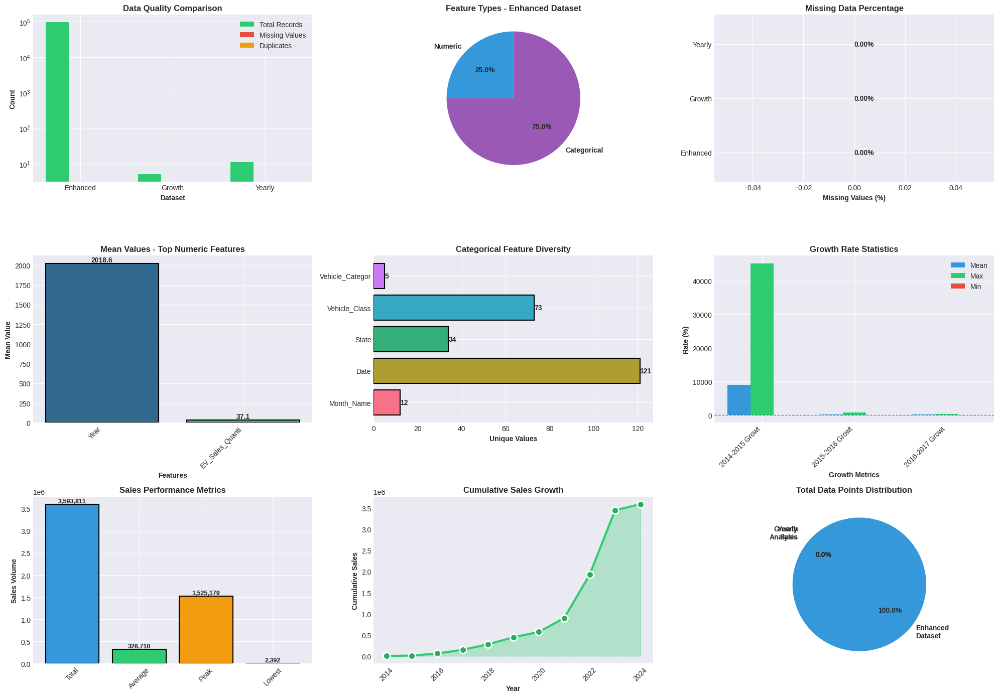

In [10]:
print("\n" + "="*80)
print("5. KEY INSIGHTS & SUMMARY")
print("="*80)

print("\n📊 ENHANCED EV DATASET INSIGHTS:")
print(f"• Total number of records: {len(df_enhanced):,}")
print(f"• Number of features: {len(df_enhanced.columns)}")
print(f"• Missing values: {df_enhanced.isnull().sum().sum()}")
print(f"• Duplicate records: {df_enhanced.duplicated().sum()}")

if len(numeric_cols) > 0:
    print(f"\n📈 Numeric Features: {len(numeric_cols)}")
    for col in numeric_cols[:5]:
        print(f"  - {col}: Mean = {df_enhanced[col].mean():.2f}, Std = {df_enhanced[col].std():.2f}")

if len(categorical_cols) > 0:
    print(f"\n📋 Categorical Features: {len(categorical_cols)}")
    for col in categorical_cols[:5]:
        print(f"  - {col}: {df_enhanced[col].nunique()} unique values")

print("\n📊 GROWTH RATE ANALYSIS INSIGHTS:")
print(f"• Total records: {len(df_growth):,}")
if growth_cols:
    for col in growth_cols[:3]:
        if col in df_growth.columns:
            print(f"  - {col}: Mean = {df_growth[col].mean():.2f}%, Max = {df_growth[col].max():.2f}%")

print("\n📊 YEARLY SALES TREND INSIGHTS:")
print(f"• Total years covered: {len(df_yearly)}")
if sales_cols and len(df_yearly) > 1:
    first_col = sales_cols[0]
    total_growth = ((df_yearly[first_col].iloc[-1] - df_yearly[first_col].iloc[0]) / df_yearly[first_col].iloc[0] * 100)
    print(f"  - Total growth over period: {total_growth:.2f}%")
    print(f"  - Average annual sales: {df_yearly[first_col].mean():,.0f}")
    print(f"  - Peak sales: {df_yearly[first_col].max():,.0f}")

# ============================================================================
# 6. KEY INSIGHTS VISUALIZATIONS
# ============================================================================
print("\n" + "="*80)
print("6. KEY INSIGHTS VISUALIZATIONS")
print("="*80)

fig = plt.figure(figsize=(20, 14))

# Plot 1: Data Quality Overview
plt.subplot(3, 3, 1)
quality_data = {
    'Enhanced': [len(df_enhanced), df_enhanced.isnull().sum().sum(), df_enhanced.duplicated().sum()],
    'Growth': [len(df_growth), df_growth.isnull().sum().sum(), df_growth.duplicated().sum()],
    'Yearly': [len(df_yearly), df_yearly.isnull().sum().sum(), df_yearly.duplicated().sum()]
}
x = np.arange(len(quality_data))
width = 0.25
plt.bar(x - width, [quality_data[k][0] for k in quality_data.keys()], width, label='Total Records', color='#2ecc71')
plt.bar(x, [quality_data[k][1] for k in quality_data.keys()], width, label='Missing Values', color='#e74c3c')
plt.bar(x + width, [quality_data[k][2] for k in quality_data.keys()], width, label='Duplicates', color='#f39c12')
plt.xlabel('Dataset', fontweight='bold')
plt.ylabel('Count', fontweight='bold')
plt.title('Data Quality Comparison', fontsize=12, fontweight='bold')
plt.xticks(x, quality_data.keys())
plt.legend()
plt.yscale('log')

# Plot 2: Feature Types in Enhanced Dataset
plt.subplot(3, 3, 2)
feature_types = {
    'Numeric': len(numeric_cols),
    'Categorical': len(categorical_cols)
}
colors = ['#3498db', '#9b59b6']
plt.pie(feature_types.values(), labels=feature_types.keys(), autopct='%1.1f%%', 
        colors=colors, startangle=90, textprops={'fontsize': 10, 'fontweight': 'bold'})
plt.title('Feature Types - Enhanced Dataset', fontsize=12, fontweight='bold')

# Plot 3: Missing Values Percentage by Dataset
plt.subplot(3, 3, 3)
missing_pct_data = {
    'Enhanced': (df_enhanced.isnull().sum().sum() / (df_enhanced.shape[0] * df_enhanced.shape[1]) * 100),
    'Growth': (df_growth.isnull().sum().sum() / (df_growth.shape[0] * df_growth.shape[1]) * 100),
    'Yearly': (df_yearly.isnull().sum().sum() / (df_yearly.shape[0] * df_yearly.shape[1]) * 100)
}
bars = plt.barh(list(missing_pct_data.keys()), list(missing_pct_data.values()), color=['#e74c3c', '#3498db', '#2ecc71'])
plt.xlabel('Missing Values (%)', fontweight='bold')
plt.title('Missing Data Percentage', fontsize=12, fontweight='bold')
for i, bar in enumerate(bars):
    width = bar.get_width()
    plt.text(width, bar.get_y() + bar.get_height()/2, f'{width:.2f}%', 
             ha='left', va='center', fontweight='bold')

# Plot 4: Top Numeric Features Statistics (Enhanced Dataset)
if len(numeric_cols) > 0:
    plt.subplot(3, 3, 4)
    top_cols = numeric_cols[:5]
    means = [df_enhanced[col].mean() for col in top_cols]
    x_pos = np.arange(len(top_cols))
    bars = plt.bar(x_pos, means, color=sns.color_palette("viridis", len(top_cols)), edgecolor='black', linewidth=1.5)
    plt.xlabel('Features', fontweight='bold')
    plt.ylabel('Mean Value', fontweight='bold')
    plt.title('Mean Values - Top Numeric Features', fontsize=12, fontweight='bold')
    plt.xticks(x_pos, [col[:15] for col in top_cols], rotation=45, ha='right')
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.1f}', ha='center', va='bottom', fontweight='bold')

# Plot 5: Categorical Feature Diversity
if len(categorical_cols) > 0:
    plt.subplot(3, 3, 5)
    cat_diversity = {col[:15]: df_enhanced[col].nunique() for col in categorical_cols[:5]}
    bars = plt.barh(list(cat_diversity.keys()), list(cat_diversity.values()), 
                    color=sns.color_palette("husl", len(cat_diversity)), edgecolor='black', linewidth=1.5)
    plt.xlabel('Unique Values', fontweight='bold')
    plt.title('Categorical Feature Diversity', fontsize=12, fontweight='bold')
    for i, bar in enumerate(bars):
        width = bar.get_width()
        plt.text(width, bar.get_y() + bar.get_height()/2, f'{int(width)}', 
                 ha='left', va='center', fontweight='bold')

# Plot 6: Growth Rate Statistics
if growth_cols and len(growth_cols) > 0:
    plt.subplot(3, 3, 6)
    growth_stats = {col[:15]: [df_growth[col].mean(), df_growth[col].max(), df_growth[col].min()] 
                    for col in growth_cols[:3]}
    x = np.arange(len(growth_stats))
    width = 0.25
    means = [growth_stats[k][0] for k in growth_stats.keys()]
    maxs = [growth_stats[k][1] for k in growth_stats.keys()]
    mins = [growth_stats[k][2] for k in growth_stats.keys()]
    plt.bar(x - width, means, width, label='Mean', color='#3498db')
    plt.bar(x, maxs, width, label='Max', color='#2ecc71')
    plt.bar(x + width, mins, width, label='Min', color='#e74c3c')
    plt.xlabel('Growth Metrics', fontweight='bold')
    plt.ylabel('Rate (%)', fontweight='bold')
    plt.title('Growth Rate Statistics', fontsize=12, fontweight='bold')
    plt.xticks(x, growth_stats.keys(), rotation=45, ha='right')
    plt.legend()
    plt.axhline(y=0, color='black', linestyle='--', linewidth=1, alpha=0.5)

# Plot 7: Sales Performance Overview
if sales_cols and len(df_yearly) > 1:
    plt.subplot(3, 3, 7)
    first_col = sales_cols[0]
    total_sales = df_yearly[first_col].sum()
    avg_sales = df_yearly[first_col].mean()
    max_sales = df_yearly[first_col].max()
    min_sales = df_yearly[first_col].min()
    
    metrics = ['Total', 'Average', 'Peak', 'Lowest']
    values = [total_sales, avg_sales, max_sales, min_sales]
    colors_sales = ['#3498db', '#2ecc71', '#f39c12', '#e74c3c']
    bars = plt.bar(metrics, values, color=colors_sales, edgecolor='black', linewidth=1.5)
    plt.ylabel('Sales Volume', fontweight='bold')
    plt.title('Sales Performance Metrics', fontsize=12, fontweight='bold')
    plt.xticks(rotation=45)
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:,.0f}', ha='center', va='bottom', fontweight='bold', fontsize=9)

# Plot 8: Cumulative Growth Trend
if sales_cols and len(df_yearly) > 1 and year_cols_yearly:
    plt.subplot(3, 3, 8)
    first_col = sales_cols[0]
    cumulative = df_yearly[first_col].cumsum()
    plt.plot(df_yearly[year_cols_yearly[0]], cumulative, marker='o', linewidth=3, 
             markersize=10, color='#2ecc71', markerfacecolor='#27ae60', markeredgecolor='white', markeredgewidth=2)
    plt.fill_between(df_yearly[year_cols_yearly[0]], cumulative, alpha=0.3, color='#2ecc71')
    plt.xlabel('Year', fontweight='bold')
    plt.ylabel('Cumulative Sales', fontweight='bold')
    plt.title('Cumulative Sales Growth', fontsize=12, fontweight='bold')
    plt.grid(True, alpha=0.3, linestyle='--')
    plt.xticks(rotation=45)

# Plot 9: Dataset Size Comparison
plt.subplot(3, 3, 9)
sizes = {
    'Enhanced\nDataset': df_enhanced.shape[0] * df_enhanced.shape[1],
    'Growth\nAnalysis': df_growth.shape[0] * df_growth.shape[1],
    'Yearly\nSales': df_yearly.shape[0] * df_yearly.shape[1]
}
explode = (0.1, 0, 0)
colors_size = ['#3498db', '#e74c3c', '#2ecc71']
plt.pie(sizes.values(), labels=sizes.keys(), autopct='%1.1f%%', explode=explode,
        colors=colors_size, startangle=140, textprops={'fontsize': 10, 'fontweight': 'bold'})
plt.title('Total Data Points Distribution', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()



7. COMPREHENSIVE INSIGHTS DASHBOARD


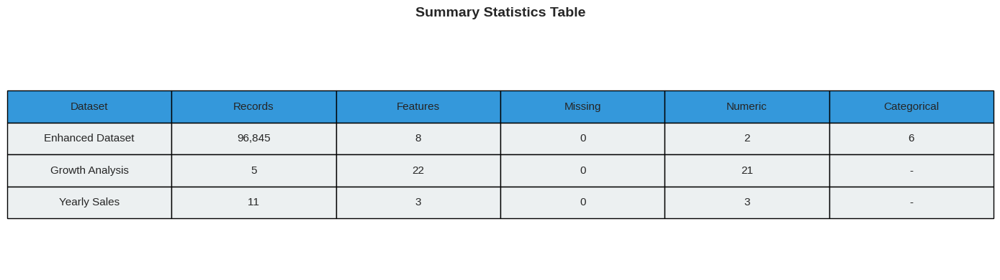


✓ EDA ANALYSIS COMPLETE!


In [11]:
print("\n" + "="*80)
print("7. COMPREHENSIVE INSIGHTS DASHBOARD")
print("="*80)

# Create two separate figures to avoid size issues
fig1 = plt.figure(figsize=(18, 7))

# Combined insights plot
plt.subplot(1, 1, 1)
datasets = ['Enhanced', 'Growth', 'Yearly']
records = [len(df_enhanced), len(df_growth), len(df_yearly)]
features = [df_enhanced.shape[1], df_growth.shape[1], df_yearly.shape[1]]

x = np.arange(len(datasets))
width = 0.35
bars1 = plt.bar(x - width/2, records, width, label='Records', color='#3498db', edgecolor='black', linewidth=2)
plt.ylabel('Number of Records', fontweight='bold', fontsize=11)
plt.xlabel('Dataset', fontweight='bold', fontsize=11)
plt.title('Dataset Overview: Records and Features', fontsize=14, fontweight='bold')
plt.xticks(x, datasets)
plt.legend(loc='upper left')

# Add secondary y-axis for features
ax2 = plt.gca().twinx()
bars2 = ax2.bar(x + width/2, features, width, label='Features', color='#2ecc71', edgecolor='black', linewidth=2)
ax2.set_ylabel('Number of Features', fontweight='bold', fontsize=11)
ax2.legend(loc='upper right')

# Add value labels on bars
for bar in bars1:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
            f'{int(height)}', ha='center', va='bottom', fontweight='bold')

for bar in bars2:
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height,
            f'{int(height)}', ha='center', va='bottom', fontweight='bold')

plt.tight_layout()
plt.show()

# Summary Statistics Table (separate figure)
fig2, ax = plt.subplots(figsize=(14, 4))
summary_data = []
summary_data.append(['Enhanced Dataset', f"{len(df_enhanced):,}", f"{df_enhanced.shape[1]}", 
                     f"{df_enhanced.isnull().sum().sum()}", f"{len(numeric_cols)}", f"{len(categorical_cols)}"])
summary_data.append(['Growth Analysis', f"{len(df_growth):,}", f"{df_growth.shape[1]}", 
                     f"{df_growth.isnull().sum().sum()}", f"{len([c for c in df_growth.columns if df_growth[c].dtype in [np.float64, np.int64]])}", "-"])
summary_data.append(['Yearly Sales', f"{len(df_yearly):,}", f"{df_yearly.shape[1]}", 
                     f"{df_yearly.isnull().sum().sum()}", f"{len([c for c in df_yearly.columns if df_yearly[c].dtype in [np.float64, np.int64]])}", "-"])

col_labels = ['Dataset', 'Records', 'Features', 'Missing', 'Numeric', 'Categorical']
table = ax.table(cellText=summary_data, colLabels=col_labels, cellLoc='center', loc='center',
                  colColours=['#3498db']*6, cellColours=[['#ecf0f1']*6]*3)
table.auto_set_font_size(False)
table.set_fontsize(11)
table.scale(1, 2.5)
ax.axis('off')
ax.set_title('Summary Statistics Table', fontsize=14, fontweight='bold', pad=20)

plt.tight_layout()
plt.show()

print("\n" + "="*80)
print("✓ EDA ANALYSIS COMPLETE!")
print("="*80)